<a href="https://colab.research.google.com/github/AlexandraLJones/FIRE-CloudComputing/blob/main/ContrailsFinalNotebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Using Unsupervised AI Techniques To Cluster Images Based On Cloud Types

**FIRE 298 Final Product**
Using Unsupervised AI Techniques To Cluster Images Based On Cloud Types

Charles Karafotis, Van Lin, Dhvani Patel, Nicholas Lucas Smith

12-8-20

# Introduction

Research Topic

For FIRE-CC Contrails group we have developed a Google Colab notebook with the intention to organize and identify different cloud types based on images in the GLOBE Clouds dataset from NASA. For our project, we have centered our attention on creating different feature vectors that result in well unsupervised clusters of cloud types based on ground observers images. Our team created multiple objectives that input ground based observation images and output clusters based on cloud types(NOAA SciJinks). By creating a clustering model that automaticaly sorts cloud images, citizen scientists can easily use the GLOBE clouds system and the margin of error for wrong classifications decreases.

Importance of a Cloud
	
  To truly understand the importance of our research, it’s necessary to dive into what a Cloud is and why cloud observations are critical for scientific research. In simple terms, clouds are collections of tiny particles composed of two main ingredients: water vapor and aerosols(The Importance of Understanding Clouds). To make predictions on weather phenomena, categorizing and interpreting cloud images is of great importance. Satellite and Citizen Science observations of clouds, lead to the most accurate and comprehensive databases of Earth’s cloud observations. These observations allow for improvements in satellite missions, Earth’s model validations, as well as for seasonal and long term climate predictions(The Importance of Understanding Clouds). Clouds also control atmospheric and surface temperature and humidity as well as atmospheric and oceanic circulation and precipitation patterns all of which affect our daily lives in fundamental ways. 
 
Motivation

After learning about the impact clouds can have in scientific research, we decided to combine our interests in machine learning with this atmospheric topic to develop an efficient model that clusters cloud images with the use of a pre-trained neural network(Dombrowski). Throughout the project we referenced and utilized various AI and atmospheric science literature to build a final product that properly encapsulated the issues we wanted to address. 


# Dependencies

The libraries included below are all the dependencies that were used in the project. Below is a description of each library and what it was used for in the project. 

1.   The `pandas` library, imported as pd, is used in several sections of the project. Mainly, it is used in the *Reading The .csv File* section which is used to read the data into the project and filtering the data to the needs of the project.
2.   The `google.colab` library is used to import the drive functionality. This is used throughout the project as all of the data used is stored in our [shared google drive account](https://drive.google.com/drive/folders/1r9sR_Wi8ByIedfgbQCeWjVp6toKLY0o7?usp=sharing). This includes the photos we download for our data extraction step and the pickle file that holds our extracted features file.
3.   The `requests` library is used in the *Downloading Images and Moving to Google Drive* section of the project. The requests library allows for the project to access websites and in our case download images that we then stored in our shared google drive.
4.   The `pydrive.auth` library is used in the *Downloading Images and Moving to Google Drive* section of the project. This package is an API for python that allows for us to upload images to the shared google drive.
5.   The `pydrive.drive` library is used in the *Downloading Images and Moving to Google Drive* section of the project. This package is an API that was necessary to allow for uploading images to the shared google drive.
6.   The `google.colab` library is used for accessing features for google colab. This call imports the auth package which allows for us to authenticate the project with the google colab API.
7.   The `oauth2client.client` library is used for the *Downloading Images and Moving to Google Drive* section of the project. This was necessary to authenticate our project with google drive to allow us to upload files.
8.   The `os` library is used in several sections of the project. This library was necessary to access methods, most notably the open() function.
9.   The `keras` library is used throughout the project. This library allows us to bring in several models that can be used in our project. For this notebook, we have elected to use the VGG16 model that can be found in keras library.
10.  From the `keras` library, we imported the image package. This package allows for us to turn an image into an array which is necessary for calculations that are used throughout the project.
11.  From the `keras` library, we imported the decode_predictions and preprocess_input packages. This allowed us to display the different layers of the model that we selected with the model_picker() function. 
12.  From the `keras` library, we imported the models package. This package allows us to gain access to all of the models that the keras package offers. This is mainly used in the model_picker() function which allows users to select the model they wish to use for the project.
13.  The `tensorboard.keras.applications.vgg16` library was used initally to import the VGG16 model before the model_picker() function was implemented. This allows for quick access to the VGG16 object if needed for testing purposes.
14.  The library `numpy` is imported as np into the project. This library is used for more advanced mathmatical functions and manipulations of arrays. 
15.  The library `matplotlib.pyplot` is imported as plt into the project. This library allows for us to plot different graphs that visualize the data acquired.
16.  The library `time` is imported into the project and used to keep the time that it takes to analyze the images that are sent through the model.
17.  The library `sklearn.decomposition import PCA` was used in the project in the *Feature Extraction Using VGG16 Model* section. This library allowed for us to extract the key features of each image using principal component analysis. 
18.  The library `random` was used in the project for the *PCA to Visualize Our Images* section. This library allows for the random selection of images which is used to show the predicted model's accuracy.
19.  The library `scipy.spatial import distance` was used in the project. This library allows for us to calculate the relative distances of the realtive images found from the model's predictions. 
20.  The library `pickle` was used in this project. Pickle allows us to save our features that were extracted in the PCA process to our shared google drive space.
21.  The library `json` was used in parts of the project. This library was used to ease the process of storing and exchanging data
22.  The library `PIL import Image` was used in the *TSNE Implementation* and *Tensorboard Implementation* sections of the project. This allowed for images to be opened and displayed in visual representations.
23.  The library `sklearn.manifold import TSNE` in the *TSNE Implementation* section of the project. This was used to visualize the model in 2-D through a TSNE graph.
24.  The library `cv2` was used in the *Tensorboard Implementation* section. This library allows us to resize images before adding them to an array that was used in the process to create a tensorboard.
25.  The library `tensorflow as tf` was used in the *Tensorboard Implementation* section of the project. This allows us to make a tensorboard object in the project.
26.  The library `tensorboard.plugins import projector` was used in the *Tensorboard Implementation* section of the project. This allows us to display the tensorboard created in the google colab notebook.

In [ ]:
#all the libraries in the code blocks now go here

# Libraries used in Reading the .csv File section
import pandas as pd
from google.colab import drive

# Libraries used in Downloading images and moving to Google Drive section
import requests
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Libraries used in Objective One secton
import os
import keras
from keras.preprocessing import image
from keras.applications.imagenet_utils import decode_predictions, preprocess_input
from keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16

# Libraries used for Feature Extraction Using VGG16 Model section
import numpy as np
import matplotlib.pyplot as plt
import time

# Library used for Using PCA on Features Extracted section
from sklearn.decomposition import PCA

# Library used for Using PCA to Visualize Our Images section
import random
from scipy.spatial import distance
import pickle

# Library used for TSNE Implementation
import json
import matplotlib.pyplot
from matplotlib.pyplot import imshow
from PIL import Image
from sklearn.manifold import TSNE

# Libraries used for Tensorboard Implementation
import cv2
import tensorflow as tf
from tensorboard.plugins import projector

Below is a dependency that allows for our Google Colab Notebooks to read files in the shared drive that have different viewer permission requirements.

In [ ]:
#solution from google colab
!sed -i -e 's/enforce_single_parent:true/enforce_single_parent:true,metadata_cache_reset_counter:4/' /usr/local/lib/python3.6/dist-packages/google/colab/drive.py

import importlib
_ = importlib.reload(drive)

# Data

Globe Cloud Data Set

The dataset used within our research project was the GLOBE Clouds dataset which consists of citizen science cloud observations that were gathered from the GLOBE Observer app whose purpose is to help you document what you see in the sky. The data we utilized is from the years 2017, 2018, and 2019 which can be found on the Clouds data section of the Observer Globe website in the form of three separate csv files. Each file consists of a series of columns that represent a separate characteristic of the observation such as time, cloud type, etc.

Data Filtration 

For the purposes of our research, we are interested in the columns “is GLOBE trained”, and all of the Cloud type columns such as “Cirrus”, “Stratus”, etc. For the “is GLOBE trained” column we had to filter out all rows with 0 as input and only keep observations for trained scientists. As for the Cloud type columns, we had to ensure that only one type was selected for each observation. 

Data Processing

In order to use the GLOBE data within our code, we decided to combine the csv files for all the years using the pandas library. After the initial concatanation was done, we were able to extract all of the image links for the observations and import them onto a shared Google drive. This process allowed us to easily use these images for the future and also perform quality control.

Since this process only needs to be run once for our additional code to work, we have elected to link the original notebook containing this source code [here](https://colab.research.google.com/drive/1Mr0KuZc2ENCu9lj59I60qTpmK9skJy7s?usp=sharing). 

Following this notebook, the obtained images that were downloading from this code are available to view [here](https://drive.google.com/drive/folders/1mtDKhHM722NUaxZPxbiQAKkU3YCKN9OS?usp=sharing).


# Methods

The following sections incorporates the cloud images obtained and stored from data section of this notebook and feature extraction techniques to extract features from [pre-selected cloud images](https://drive.google.com/drive/folders/1ej5A_f0NpvewxHhdZlJTgOHSn34i11CP?usp=sharing) of each type of cloud. A function is incorporated that allows for the selection of a model that can be used for feature extraction. This section produces product 1 of our project, which is a graph that shows the feature extraction process that is occurring when PCA, a feature extraction process, is applied to our pre-selected images. From this, we receive a file of the features that we store on our shared Google Drive folder. This file will be used here to graph our results and see how well our model performs. 

### Objective 1: To apply an unsupervised non-linear graph for data exploration with our images, we first need to extract features from a sample of quality controlled images. 


The first step will be to import the necessary Keras libraries that we will be using. Note that this step was already done in the dependencies section of this notebook. Keras is a free open source Python library for developing and evaluating deep learning models. It's purpose is to wrap other libraries like Theano and TensorFlow and allows for defining and training of neural network models easily. Following the import statements, we mount Google Drive to the notebook to allow for reading and writing files.

In [ ]:
# Below mounts my google drive to the program
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


This function `model_picker(name)` allows for the user to select a model that can be applied to the selected cloud images. The models that can be selected are vgg16, vgg19, mobilenet, inception, resnet, or xception. Any of these models can be passed to the `name` parameter of the function and the function will return that desired model.

In [ ]:
def model_picker(name):
    if (name == 'vgg16'):
        model = keras.applications.VGG16(weights='imagenet', include_top=True)
    elif (name == 'vgg19'):
        model = keras.applications.VGG19(weights='imagenet', include_top=True)
    elif (name == 'mobilenet'):
        model = keras.applications.MobileNet(weights='imagenet', include_top=True)
    elif (name == 'inception'):
        model = keras.applications.InceptionV3(weights='imagenet', include_top=True)
    elif (name == 'resnet'):
        model = keras.applications.ResNet50(weights='imagenet', include_top=True)
    elif (name == 'xception'):
        model = keras.applications.Xception(weights='imagenet', include_top=True)
    else:
        print("Specified model not available")
    return model

## Feature extraction using VGG16 model

In this section, we will load a previously-trained neural network(VGG16) which comes with Keras. VGG16 has 13 convolutional layers and it's purpose is to take a fixed-size as its input, and then forward this size through convolutional comprised of may layers where the last layer will be the classification layer. 

To accomplish this, we use the `model_picker(name)` function defined in the previous block of code and pass in the parameter 'vgg16'.


In [ ]:
!ls
model = model_picker('vgg16')

gdrive	sample_data
553467904/553467096 [==============================] - 3s 0us/step


To input an image into the network, it has to be pre-processed into a feature vector of the correct size. The function `load_image(path)` will handle the usual pre-processing steps: load an image from our file system and turn it into an input vector of the correct dimensions, those expected by VGG16, namely a color image of the correct size. For VGG16, this would be an image of size 224 x 224. 

shape of x:  (1, 224, 224, 3)
data type:  float32


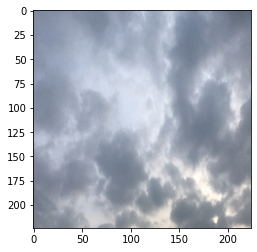

In [ ]:
#this function will load an image from our drive and turn it into an input vector of the correct dimensions
def load_image(path):
    img = image.load_img(path, target_size=model.input_shape[1:3])
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    return img, x

#the image is then displayed
img, x = load_image("/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus179.jpg")
print("shape of x: ", x.shape)
print("data type: ", x.dtype)
plt.imshow(img)

Below `feat_extractor` represents the model we selected in the beginning. For this example, this model was VGG16. Below prints out the model summary so we can visualize the different layers that VGG16 has to offer. Notice that the code below prints the before and after of the model. This is because this step removes the predictions layer of the VGG16 model. This step is important for our research since the VGG16 model was not trained on cloud data and we do not require this predictions layer for our project.

In [ ]:
print(len(model.layers))
print("Before the predictions layer was removed \n")
model.summary()

print("After the predictions layer was removed \n")
feat_extractor = Model(inputs=model.input, outputs=model.get_layer(None, (len(model.layers)-2)).output)
feat_extractor.summary()

23
Before the predictions layer was removed 

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (Ma

Now that the variable `feat_extractor` represents the correct layers of the VGG16 model that we wish to use, the following code will use the `predict()` function on an image selected from the selected cloud photos folder to extract features from it. These features will be graphed below to visualize the process. Notice how there are differences in each of the different feature graphs when compared. This is because each image has a unique set of features.

Below is a selected cloud image and the predicted values from the model 



(0.0, 10.0)

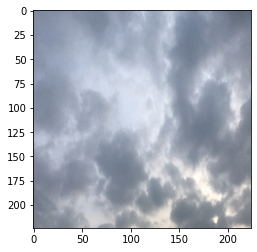

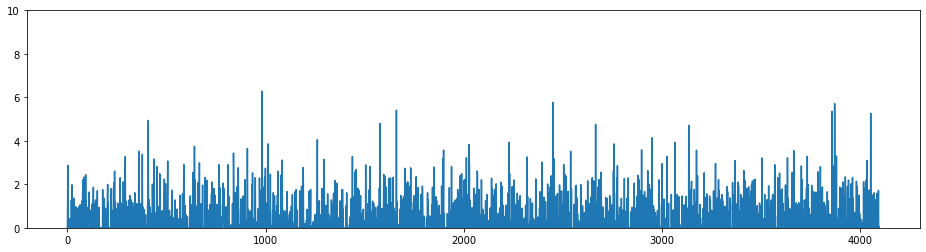

In [ ]:
print("Below is a selected cloud image and the predicted values from the model \n")
img, x = load_image("/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus179.jpg")
feat = feat_extractor.predict(x)
plt.imshow(img)
plt.figure(figsize=(16,4))
plt.plot(feat[0])
plt.ylim(0,10)

Below is another selected cloud image and the predicted values from the model 



(0.0, 10.0)

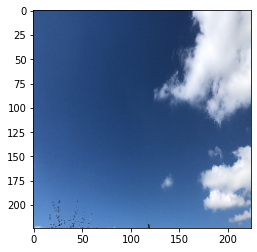

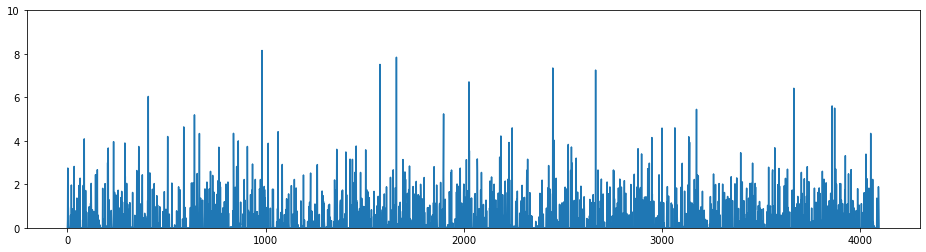

In [ ]:
print("Below is another selected cloud image and the predicted values from the model \n")
img1, x1 = load_image("/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Cumulus22.jpg")
feat1 = feat_extractor.predict(x1)
plt.imshow(img1)
plt.figure(figsize=(16,4))
plt.plot(feat1[0])
plt.ylim(0,10)

Notice the differences between the two graphs is shown using the following code. Notice how some lines are positive for the differences axis while other lines are negative for the differences axis. The positive values represent the dimensions in the `feat[0]` graph, this was the first image shown, have higher values for that dimension compared to `feat[1]` graph, which represents the second image. If the value is negative, then that dimension in image 2 was of a larger value than that of image 1. This shows us that the model is able to identify differences between each of the images that we pass through it.

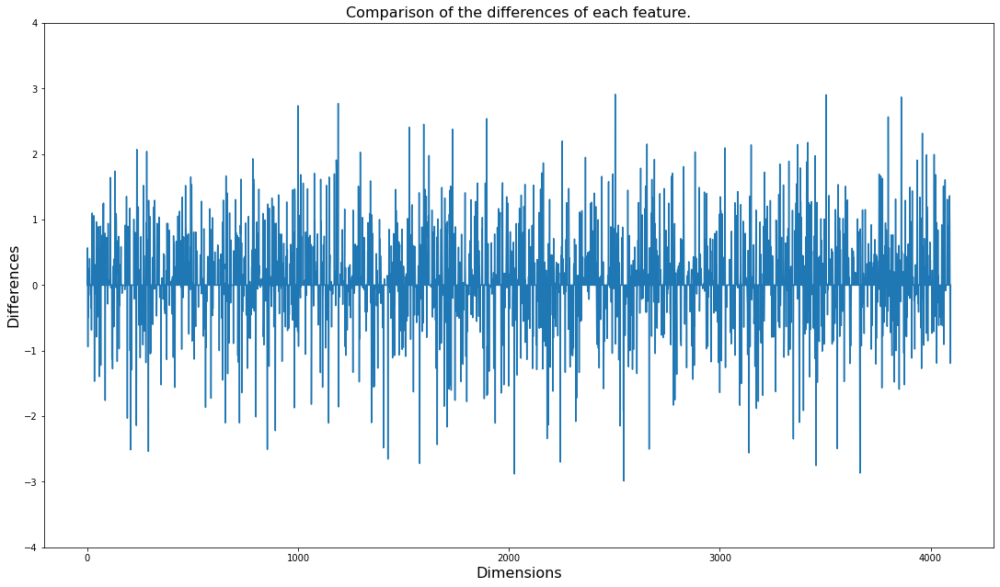

In [ ]:
plt.plot(feat[0]-feat1[0])
plt.ylim(-4,4)
plt.xlabel('Dimensions',size=16)
# set y-axis label and specific size
plt.ylabel('Differences',size=16)
# set plot title with specific size
plt.title('Comparison of the differences of each feature.',size=16)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)

Now that we understand the process that the model is doing, we will apply this to all the selected images. The code below first goes to the path in the shared Google Drive of the selected cloud image folders. The code iterates through the images in that folder and if it has the correct `image_extensions` then that image is sorted into `images`. Then a select number of the images are taken to be analyzed by the model.

In [ ]:
images_path = '/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds'
image_extensions = ['.jpg']   # case-insensitive (upper/lower doesn't matter)
#max_num_images = 200

images = [os.path.join(dp, f) for dp, dn, filenames in os.walk(images_path) for f in filenames if os.path.splitext(f)[1].lower() in image_extensions]

print("keeping %d images to analyze" % len(images))


keeping 100 images to analyze


Below we extract all the features from the selected images above. These features are then stored in a features array, called `features`, which is used in the next block to show the differences between each of the images. 

In [ ]:
tic = time.clock()

features = []
for i, image_path in enumerate(images):
    if i % 20 == 0:
        toc = time.clock()
        elap = toc-tic;
        print("analyzing image %d / %d. Time: %4.4f seconds." % (i, len(images),elap))
        tic = time.clock()
    img, x = load_image(image_path);
    feat = feat_extractor.predict(x)[0]
    features.append(feat)

print('finished extracting features for %d images' % len(images))

analyzing image 0 / 100. Time: 0.0002 seconds.
analyzing image 20 / 100. Time: 22.0762 seconds.
analyzing image 40 / 100. Time: 23.2031 seconds.
analyzing image 60 / 100. Time: 22.9992 seconds.
analyzing image 80 / 100. Time: 23.0968 seconds.
finished extracting features for 100 images


## Using PCA on features extracted

In order to use PCA, we must import it. This is done in the dependencies section of this notebook. PCA is part of the `sklearn` library and allows for the features extracted in the previous step to be reduced down in the number of dimensions. This is a technique known as dimensionality-reduction. Our group decided to use PCA dimensionality reduction due to the size of our data. The fewer dimensions that we have overall, the faster the images sent to the model we created will process.

The number of dimensions that the features were reduced down to was 7 based on the fact that most of the data can be retained with 7 diemensions while still keeping the model accurate. We came to this conclusion by graphing the percentage of relevant importance for each dimension for the images. From the graph image below, notice that around 7 dimensions, the curve starts to flatten out, indicating that most of the important features are represented in the 7 dimensions.

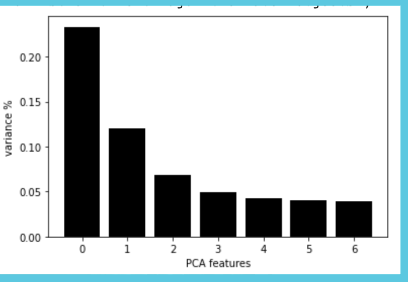


Once the library is imported, the first step is to use numpy to convert the current the features stored in the previous block into an array. This array is then fit to a PCA object called `pca`. 

In [ ]:
features = np.array(features)
pca = PCA(n_components=7)
pca.fit(features)

PCA(copy=True, iterated_power='auto', n_components=7, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

Then, we use the transform function in PCA to lower the number of dimensions stored in features. We take our original feature vector, and transform them to the new space of a 300-dimensional and store these features into pca_features.

In [ ]:
pca_features = pca.transform(features)

## Using PCA to visualize our images

Now that we have applied a PCA transformation of the features, we can use PCA to visualize images that have similar features.

Below we load in a random image from our images array. Then we display this image using the matplotlib library.

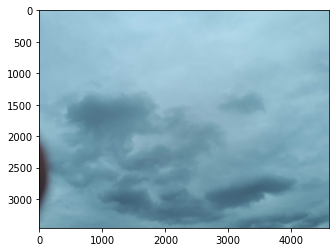

In [ ]:
# grab a random query image
query_image_idx = int(len(images) * random.random())

# let's display the image
img = image.load_img(images[query_image_idx])
plt.imshow(img)

Next, we are going to use `distance`, which was imported in the dependencies section of the notebook. This will allow us to use the `pca_features` we have extracted for the randomly selected image and compare them to other images' pca features. The queried image will be compared to all the other images and the distances of similarity will be stored in similar_idx

In [ ]:
similar_idx = [ distance.cosine(pca_features[query_image_idx], feat) for feat in pca_features ]

Now we will sort the `similar_idx` array that we just created. Following the sorting, we will take the first 5 images that were stored in the `idx_closest` array. These should all be images that closely resemble the original image loaded above. 

To make it easier to see, the five similar images that are loaded here are concatenated into a single image for quick comparison. 

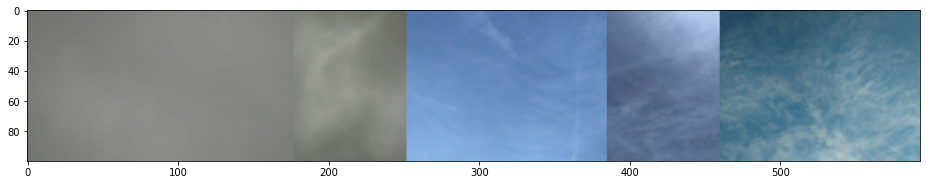

In [ ]:
idx_closest = sorted(range(len(similar_idx)), key=lambda k: similar_idx[k])[1:6]
# load all the similarity results as thumbnails of height 100
thumbs = []
for idx in idx_closest:
    img = image.load_img(images[idx])
    img = img.resize((int(img.width * 100 / img.height), 100))
    thumbs.append(img)

# concatenate the images into a single image
concat_image = np.concatenate([np.asarray(t) for t in thumbs], axis=1)

# show the image
plt.figure(figsize = (16,12))
plt.imshow(concat_image)

From the resulting array of closely matching images that was returned by the model, we believe our model was very successful in identifying pictures that have similar color hues. However, we need to use more test images overall before we can conclude that the model we have developed so far is able to classify images by on the type of cloud that was passed into the model.

To facilitate the process above, the code was then reduced into two functions, defined below, that allow for this process to be streamlined for any image. 

The functions are `get_closest_images()` and `get_concatenated_images()`. 

The first function calculates the closest images based on the image passed in and by default returns the first five in an array. Note that the amount of images in the return array can be altered by passing in a second parameter, which is an integer representing the number of similar images you wish to receive.

The second function creates and returns an image that combines all of the similar images found from the first function into one image that allows for quick comparison.

In [ ]:
def get_closest_images(query_image_idx, num_results=5):
    distances = [ distance.cosine(pca_features[query_image_idx], feat) for feat in pca_features ]
    idx_closest = sorted(range(len(distances)), key=lambda k: distances[k])[1:num_results+1]
    return idx_closest

def get_concatenated_images(indexes, thumb_height):
    thumbs = []
    for idx in indexes:
        img = image.load_img(images[idx])
        img = img.resize((int(img.width * thumb_height / img.height), thumb_height))
        thumbs.append(img)
    concat_image = np.concatenate([np.asarray(t) for t in thumbs], axis=1)
    return concat_image

Using the same steps as above, we show that the process can now go much faster using the newly defined functions. 

First we select a random image then display it. Following that, we display the resulting images that are calculated using the `get_closest_image()` function and the `get_concatenated_images()` function.

Text(0.5, 1.0, 'query image (52)')

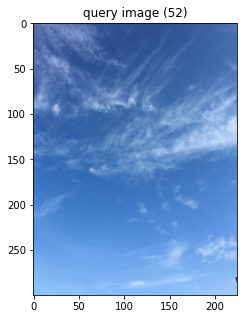

In [ ]:
# do a query on a random image
query_image_idx = int(len(images) * random.random())
idx_closest = get_closest_images(query_image_idx)
query_image = get_concatenated_images([query_image_idx], 300)
results_image = get_concatenated_images(idx_closest, 200)

# display the query image
plt.figure(figsize = (5,5))
plt.imshow(query_image)
plt.title("query image (%d)" % query_image_idx)

Text(0.5, 1.0, 'result images')

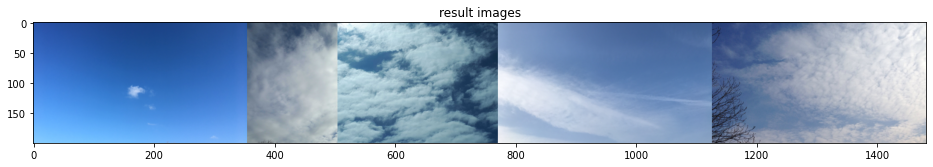

In [ ]:
# display the resulting images
plt.figure(figsize = (16,12))
plt.imshow(query_image)
plt.imshow(results_image)
plt.title("result images")

Now that we have seen our PCA features in action, we will use the `pickle` library which will allow us to save the `pca_features` for each image into a file. This file, called Features, will be stored into our [ColabNotebook folder](https://drive.google.com/drive/folders/1LYSvhwMtPxNdhhLj6pWZj7jU8zYVZhxM?usp=sharing) on the shared Google Drive. 

This file is required for the following steps of this notebook which use the features to visualize our data. 

In [ ]:
pickle.dump([images,pca_features, pca], open('/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/ColabNotebook/Features', 'wb'))

## T-SNE implementation 

This part of the notebook experiments with the T-SNE 2-D graph. This step was one that we decided to take to see if we could make out any distinct clusters in 2-D space before implemention of the 3-D version in the final section of this methods section.

First we need to load in the feature file that is saved in the shared Google Drive in the previous section of the notebook. This file is called Features. Using the `pickle.load()` function, we bring in the file to this part of the code.

In [ ]:
images, pca_features, pca = pickle.load(open('/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/ColabNotebook/Features', 'rb'))

To make sure our `pca_features` have loaded in correctly, we print out the first 4 features from the first 5 images to confirm everything loaded in properly. As we can see below, the features have been properly loaded back in to the variables.

In [ ]:
for img, f in list(zip(images, pca_features))[0:5]:
    print("image: %s, features: %0.2f,%0.2f,%0.2f,%0.2f... "%(img, f[0], f[1], f[2], f[3]))

image: /content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus1.jpg, features: 8.40,0.66,-9.56,-5.09... 
image: /content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus8.jpg, features: 0.55,-3.51,-4.64,-0.60... 
image: /content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus14.jpg, features: -10.20,12.70,5.42,-3.67... 
image: /content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus57.jpg, features: 13.76,-3.94,2.91,-7.93... 
image: /content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/Cloud Photos/SelectedClouds/Copy of Stratocumulus72.jpg, features: 14.29,8.47,15.70,-6.88... 


Next we begin the implementation of the T-SNE graph. This is done by plotting the 100 images we have from `pca_features`. To do this we convert the `pca_features` to an array called `X` using the numpy function `np.array()`. 

Following this, X is then `fit_transform()` to a TSNE object called `tsne`.

In [ ]:
num_images_to_plot = 100

if len(images) == num_images_to_plot:
    sort_order = sorted(random.sample(range(len(images)), num_images_to_plot))
    images = [images[i] for i in sort_order]
    pca_features = [pca_features[i] for i in sort_order]

X = np.array(pca_features)
tsne = TSNE(n_components=2, learning_rate=150, perplexity=30, angle=0.2, verbose=2).fit_transform(X)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.000s...
[t-SNE] Computed neighbors for 100 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 9.875856
[t-SNE] Computed conditional probabilities in 0.017s
[t-SNE] Iteration 50: error = 52.9348526, gradient norm = 0.6714819 (50 iterations in 0.032s)
[t-SNE] Iteration 100: error = 55.8686752, gradient norm = 0.5659140 (50 iterations in 0.030s)
[t-SNE] Iteration 150: error = 53.5726624, gradient norm = 0.5950374 (50 iterations in 0.030s)
[t-SNE] Iteration 200: error = 54.6972656, gradient norm = 0.6290665 (50 iterations in 0.030s)
[t-SNE] Iteration 250: error = 57.7314529, gradient norm = 0.5355232 (50 iterations in 0.034s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.731453
[t-SNE] Iteration 300: error = 0.6248357, gradient norm = 0.0117652 (50 iterations in 0.043s)
[t-SNE] Iteration 350: error = 0.4213350, gradient norm = 0.0030070 (

We then fit the correct axes to the variables `tx` and `ty`.

In [ ]:
tx, ty = tsne[:,0], tsne[:,1]
tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
ty = (ty-np.min(ty)) / (np.max(ty) - np.min(ty))

We then graph the resulting T-SNE model.

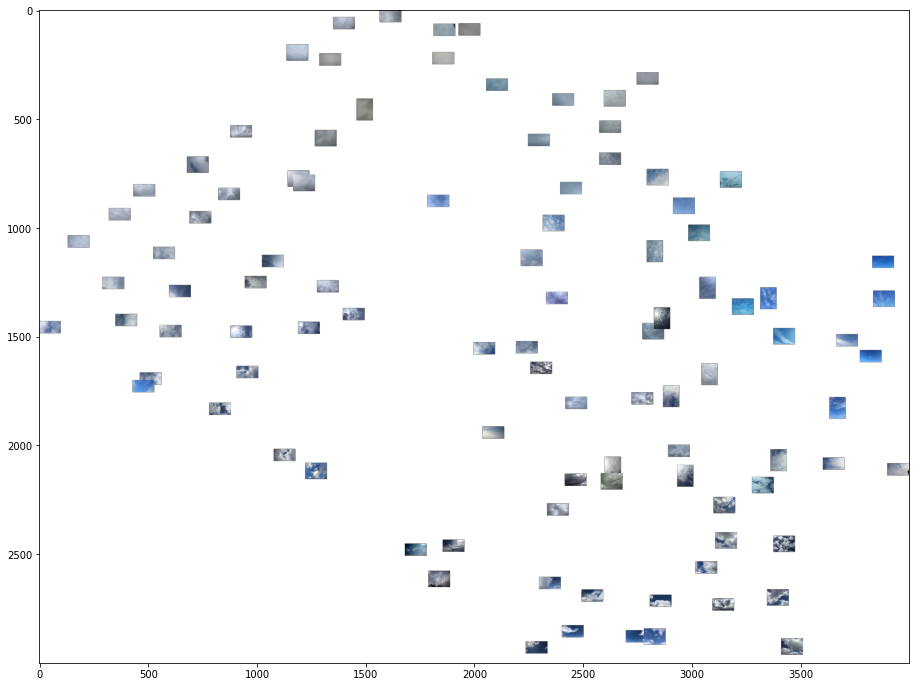

In [ ]:
width = 4000
height = 3000
max_dim = 100

full_image = Image.new('RGBA', (width, height))
for img, x, y in zip(images, tx, ty):
    tile = Image.open(img)
    rs = max(1, tile.width/max_dim, tile.height/max_dim)
    tile = tile.resize((int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
    full_image.paste(tile, (int((width-max_dim)*x), int((height-max_dim)*y)), mask=tile.convert('RGBA'))

matplotlib.pyplot.figure(figsize = (16,12))
imshow(full_image)

From this graph, we weren't able to immediately identify 10 distinct cloud type clusters. We noticed that in some regions of the T-SNE graph such as the upper right, the images of the clouds look more grey and have less blue sky in them while the bottom left cluster has more images that have scattered clouds and blue sky as the background. This may be because our model is focusing on the color of the images more than the clouds themselves. 

During this process of plotting a T-SNE graph using our images, we decided to choose the parameters we did through a process of elimination. We were striving to find distinct cluster types based on the clouds that existed in the images. In the graph that is seen above, this is the closest we came to having some identifiable clusters that appear to have cloud clusters of the same type.

However, this is a 2D representation of our model. As a group we wanted to be able to visualize our model in 3D to make sure the clusters we were seeing above also exist in a 3D space. To produce a 3D version of a T-SNE graph, we used a Tensor-Board implementation.

## TensorBoard Implementation

In this section, we use a library called `tensorboard` to visualize our model. Tensorboard will allow us to create a 3-D visualization of our model, see clusters, and edit learning rates and perplexity in real time through the projector application. 

First, we test if the correct version of tensorflow has been added to the language. If not, this is just skipped over.

In [ ]:
try:
  %tensorflow_version 2.x
except:
  pass

%load_ext tensorboard

This block sets up the directory logs inside the contents folder. This will store on the Google Colab notebook's file system, not the user's local machine. One can access this folder by hitting the folder icon that is at the far left of the user interface. This is under the code snippets button. 

The code checks if the folder already exists and if not, the folder is created in the correct location.

In [ ]:
# Sets up a folder to save all the data needed for tensorboard to work
log_dir = '/content/logs/'
if not os.path.exists(log_dir):
  os.makedirs(log_dir)


Following this, the google drive is mounted to the program. This allows for us to retrieve the pickle file saved from the previous sections. This file contains the images and the pca features that were extracted in the notebook.

In [ ]:
# Below mounts my google drive to the program

drive.mount('/content/gdrive', force_remount=True)

images, pca_features, pca = pickle.load(open('/content/gdrive/Shared drives/FIRE-CC/FIRE298/Contrails/ColabNotebook/Features', 'rb'))

plt.show(images[0])

Mounted at /content/gdrive


In this block, we define the `load_image()` function. This is done so we can store the images in an image array. This array will be used in a future block to create a sprite image which is necessary for images to apprear on the tensorboard. All the images are resized to 224 x 224 using the `cv2.resize()` function. This was done to keep all the images uniform when they appear on the tensorboard.

In [ ]:
# this function will load an image from our drive and turn it into an input
# vector of the correct dimensions
def load_image(path):
    img = image.load_img(path)
    return img


img_data = []
for img in images:
  img_to_save = cv2.imread(img)
  img_to_save_resize = cv2.resize(img_to_save,(224,224))
  img_data.append(img_to_save_resize)
  

img_data = np.array(img_data)

In this block, a feature vector is created which holds all of the features that were found. The dimensions of the feature vector are printed. Notice that there are 100 images and each image has 7 dimensions. 

In [ ]:
feature_vectors = pca_features
print("feature vector shape", feature_vectors.shape)
print("Number of images:", pca_features.shape[0])
print("Number of dimensions:", pca_features.shape[1])

num_of_samples = feature_vectors.shape[0]
num_of_samples_each_class = 10

features = tf.Variable(feature_vectors, name='features')


feature vector shape (100, 7)
Number of images: 100
Number of dimensions: 7


In this block a function is defined that finds each cloud type from the image path. These image paths are what will appear in the metafile that is used to label all the images in the tensorboard.

In [ ]:
# Used in next step to organize the clouds 
type_of_cloud = ['Cirrus','Cirrocumulus','Cirrostratus','Altostratus','Altocumulus','Cumulus','Nimbostratus','Stratus','Stratocumulus','Cumulonimbus']
clouds_organized_by_path = {'Cirrus': [],'Cirrocumulus': [],'Cirrostratus': [],'Altostratus': [],'Altocumulus': [],'Cumulus': [],'Nimbostratus': [],'Stratus': [],'Stratocumulus': [],'Cumulonimbus': []}

# method for cutting cloud type of out PATH of image

def cloud_type_find(s):
  for c_type in type_of_cloud:
    if c_type in s:
      clouds_organized_by_path[c_type].append(s)
      
for img in images:
  cloud_type_find(img)


Below is the code that is used to create the metafile. This metafile is read by the tensorboard to label each image on the board with the proper path. 

In [ ]:
j=0

print('Class\tName\n')
with open(os.path.join(log_dir, 'metadata.tsv'), "w") as f:
  for c_type in clouds_organized_by_path:
    for cloud in clouds_organized_by_path[c_type]:
      j += 1
      f.write('{}\n'.format(cloud))


Class	Name



Below is a function that was borrowed from this [tutorial](https://github.com/anujshah1003/Tensorboard-own-image-data-image-features-embedding-visualization). This function allows for the creation of a sprite image from all the images that we used in creating our cloud model.

In [ ]:
def images_to_sprite(data):
        """Creates the sprite image along with any necessary padding

        Args:
          data: NxHxW[x3] tensor containing the images.

        Returns:
          data: Properly shaped HxWx3 image with any necessary padding.
        """
        if len(data.shape) == 3:
            data = np.tile(data[...,np.newaxis], (1,1,1,3))
        data = data.astype(np.float32)
        min = np.min(data.reshape((data.shape[0], -1)), axis=1)
        data = (data.transpose(1,2,3,0) - min).transpose(3,0,1,2)
        max = np.max(data.reshape((data.shape[0], -1)), axis=1)
        data = (data.transpose(1,2,3,0) / max).transpose(3,0,1,2)
        # Inverting the colors seems to look better for MNIST
        #data = 1 - data

        n = int(np.ceil(np.sqrt(data.shape[0])))
        padding = ((0, n ** 2 - data.shape[0]), (0, 0),
                (0, 0)) + ((0, 0),) * (data.ndim - 3)
        data = np.pad(data, padding, mode='constant',
                constant_values=0)
        # Tile the individual thumbnails into an image.
        data = data.reshape((n, n) + data.shape[1:]).transpose((0, 2, 1, 3)
                + tuple(range(4, data.ndim + 1)))
        data = data.reshape((n * data.shape[1], n * data.shape[3]) + data.shape[4:])
        data = (data * 255).astype(np.uint8)
        return data

Creates a sprite image using the function defined above. This image is then stored in the correct folder log_dir points to.

In [ ]:
sprite = images_to_sprite(img_data)
cv2.imwrite(os.path.join(log_dir, 'sprite_4_classes.png'), sprite)

True

This initially sets up the weights variable to have all of the features for each of the images that will eventually be passed to the TensorBoard. These weights are currently stored in the features variable.

In [ ]:
weights = features[0:][0:]


This is the final block of code. Here, all of the variables are created that are necessary for the tensorboard to work as intended. The weights are first initialized to the correct values. These values are the features saved under the features vector. Then this is saved as a tensorflow checkpoint. This is needed for the embedding process of the tensorboard.

Finally, the setup of the board happens. In this step, the tensorboard is assigned the correct paths of the sprite image, the metadata path, and the embedding files.

In [ ]:
log_dir = '/content/logs/'
weights = tf.Variable(features[0:][0:])
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

#set up config
config = projector.ProjectorConfig()
#config.model_checkpoint_path = os.path.join(log_dir, 'checkpoint')
embedding = config.embeddings.add()
embedding.tensor_name = "embedding/.ATTRIBUTES/VARIABLE_VALUE"
    
# Link this tensor to its metadata file (e.g. labels).
embedding.metadata_path = os.path.join(log_dir, 'metadata.tsv')
# Loads the sprite images in
embedding.sprite.image_path = os.path.join(log_dir, 'sprite_4_classes.png')
embedding.sprite.single_image_dim.extend([img_data.shape[1], img_data.shape[1]])
projector.visualize_embeddings(log_dir, config)

To view the model correctly, when the Tensor-Board loads up, there is a tab on the far upper right of the window. In this drop down menu, there are several options to select from. Select the option titled *Projector*. Once this option is selected, a model will load in on the Tensor-Board UI. The next step to enable the T-SNE model in 3D is to select the T-SNE button that is on the left hand side of the graph being displayed in the middle. Once this is selected, value edits are possible, such as changing the learning rate and perplexity of the model.

In [ ]:
%tensorboard --logdir /content/logs/

<IPython.core.display.Javascript object>

After developing and running the Tensor-Board shown above, we found that there were a few clusters that were forming, however our model was not able to identify 10 distinct cloud clusters with the images passed into the model. Of the clusters we were able to identify, we found that the sratus cloud type was forming a promising cluster with several of the images in that category moving together into a cluster on the graph.

From this, we are able to conclude that the model we created most likely needs more data in order to practice on. In addition, the model we currently have could be improved by applying other techniques to our images before passing them into the model. For example one approach that could be taken is to convert the images to black and white before passing them into the model. This could result in the model not trying to cluster the images based on color patterns and instead have the model focus more on the feature differences in each type of cloud. 

# Conclusion

Results

Looking solely at the images outputted by feeding in a singular picture to the model and receiving five of it’s matches, it is possible to notice that these images tend to be very similar to both the original image and the other matches. This shows that the final model does have a sense of accuracy in categorizing different cloud types. When observing the final TNSE graph, we can easily recognize that the model clustered many of the cloud images in seperate sections that represent the distinctions of cloud types and therefore we can conclude that our trained model does in fact work to some extent. However, it is also noticeable that the graph does not contain ten clusters but rather many smaller clusters of around three to five images each organized based on image similarity. This poses an issue because we originally expected to receive ten larger divisions with each group representing a different cloud type.
 
Improvements

To improve our research, we would need to train the model with a much larger set of quality controlled images to heighten the accuracy of the results. We would also need to figure out a solution that specifies the number of clusters needed(which in our case is ten) and further test the model based on these new results. Another way to increase the efficiency of the model is by pre-selecting the best type of neural network based on success rates instead of using just VGG-16. This would allow for a more accurate and successful model. As mentioned previously, we have included a model that would allow for this to be easy done with the code we have. Using the `model_picker()`, in the future we could try running the code with a different model to see if the clusters that are produced contain more of the images of each unique type of cloud in them. 

Future Research

To further improve our research, we would like to transform our model into an automated categorization system where each cluster is immediately put into a labeled cloud type folder. This would not only allow for more accurate categorizations by using an AI system rather than human predictions, but also provides a sense of quality control through the process of accurate labeling and elimination of misleading data. Further, we would like to use more of the images that the NASA GLOBE dataset has to offer. Since this project only focused with using 100 hand-picked images, due to time constraints and computer resources, to develop the model, we could improve our results using more images. Having more images could result in the model identifying the unique types of clouds and producing feature vectors that accurately represent these obsevations.

To view a full presentation of the project that was produced, follow this [link](https://prezi.com/p/gv9_0kp4iua1/?present=1). This is a prezi that was produced for the FIRE Summit event that was held in 2020. 

# Bibliography

Dombrowski, Micah. “Feature Extraction and Reverse Image Search.” Nextjournal, nextjournal.com/ml4a/image-search. 


Dutta, Stobak, and Sabnam Sengupta. “Implementation of K-Means Clustering in ECB Framework of Cloud Computing Environment.” 2017 7th International Conference on Cloud Computing, Data Science &amp; Engineering - Confluence, 2017, doi:10.1109/confluence.2017.7943165. 


Shah, Anuj. “anujshah1003/Tensorboard-Own-Image-Data-Image-Features-Embedding-Visualization.” GitHub, 15 Sept. 2007, github.com/anujshah1003/Tensorboard-own-image-data-image-features-embedding-visualization. 


“The Importance of Understanding Clouds - NASA.” The Importance of Understanding Clouds, NASA, www.nasa.gov/pdf/135641main_clouds_trifold21.pdf. 


“Types of Clouds.” NOAA SciJinks – All About Weather, 9 Nov. 2020, scijinks.gov/clouds/. 


Wattenberg, Martin, et al. “How to Use t-SNE Effectively.” Distill, 13 Oct. 2016, distill.pub/2016/misread-tsne/. 